<a href="https://colab.research.google.com/github/Kalazclint/River_gage_height_forecasting/blob/main/STAM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
path = '/content/drive/My Drive/dataset_2015_2020.xlsx'
data = pd.read_excel(path)
data.head()

,Date/Time,gage_height_ft_sensor_07377600,gage_height_ft_sensor_07377760,gage_height_ft_sensor_07378050,gage_height_ft_sensor_07380120
0,2015-01-01 00:00:00-06:00,13.79,1.91,17.87,1.70
1,2015-01-01 00:15:00-06:00,13.79,1.91,17.85,1.71
2,2015-01-01 00:30:00-06:00,13.79,1.90,17.86,1.72
3,2015-01-01 00:45:00-06:00,13.79,1.90,17.85,1.72
4,2015-01-01 01:00:00-06:00,13.79,1.90,17.85,1.72


In [ ]:
data.shape

(210431, 5)

In [ ]:
data.isnull().sum()

Date/Time                         0
gage_height_ft_sensor_07377600    0
gage_height_ft_sensor_07377760    0
gage_height_ft_sensor_07378050    0
gage_height_ft_sensor_07380120    0
dtype: int64

In [ ]:
data.describe()

,gage_height_ft_sensor_07377600,gage_height_ft_sensor_07377760,gage_height_ft_sensor_07378050,gage_height_ft_sensor_07380120
count,210431.000000,210431.000000,210431.000000,210431.000000
mean,14.138579,2.195239,19.600865,2.376064
std,1.462028,2.294581,4.158887,1.191726
min,12.960000,0.830000,16.420000,-0.280000
25%,13.450000,1.220000,17.500000,1.750000
50%,13.770000,1.480000,18.050000,2.230000
75%,14.230000,2.127746,19.540000,2.760000
max,38.980000,29.360000,54.060000,17.900000


In [ ]:
values = data.values

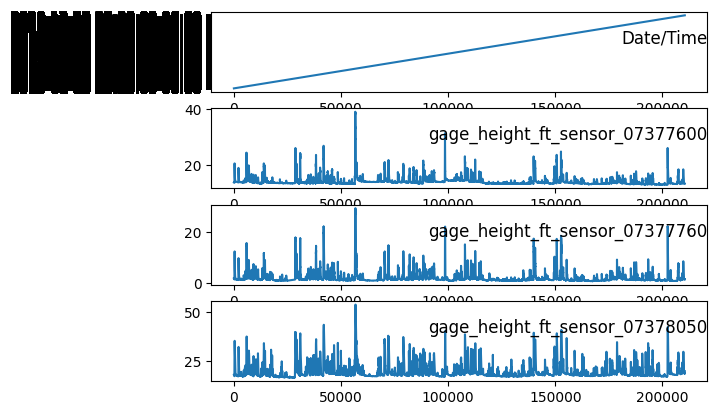

In [ ]:
groups = [0,1,2,3]
i=1

for group in groups:
    plt.subplot(len(groups),1,i)
    plt.plot(values[:,group])
    plt.title(data.columns[group], y=0.5, loc="right")
    i +=1

plt.show()


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 210431 entries, 0 to 210430
Data columns (total 5 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   Date/Time                       210431 non-null  object 
 1   gage_height_ft_sensor_07377600  210431 non-null  float64
 2   gage_height_ft_sensor_07377760  210431 non-null  float64
 3   gage_height_ft_sensor_07378050  210431 non-null  float64
 4   gage_height_ft_sensor_07380120  210431 non-null  float64
dtypes: float64(4), object(1)
memory usage: 8.0+ MB


In [ ]:
data['Date/Time'] = pd.to_datetime(data['Date/Time'])

In [ ]:

data['hour'] = data['Date/Time'].dt.hour
data['day_of_week'] = data['Date/Time'].dt.dayofweek
data['month'] = data['Date/Time'].dt.month

In [ ]:
#Resetting Index to Date data
data.set_index('Date/Time', inplace=True)

In [ ]:
# Calculate rolling statistics for each variable
rolling_mean_var1 = data['gage_height_ft_sensor_07377600'].rolling(window=12).mean()
rolling_std_var1 = data['gage_height_ft_sensor_07377600'].rolling(window=12).std()
rolling_mean_var2 = data['gage_height_ft_sensor_07377760'].rolling(window=12).mean()
rolling_std_var2 = data['gage_height_ft_sensor_07377760'].rolling(window=12).std()
rolling_mean_var3 = data['gage_height_ft_sensor_07378050'].rolling(window=12).mean()
rolling_std_var3 = data['gage_height_ft_sensor_07378050'].rolling(window=12).std()
rolling_mean_var4 = data['gage_height_ft_sensor_07380120'].rolling(window=12).mean()
rolling_std_var4 = data['gage_height_ft_sensor_07380120'].rolling(window=12).std()



In [ ]:
# Create summary statistics plot for each variable
plt.subplot(3, 1, 1)
plt.plot(data['gage_height_ft_sensor_07377600'], color='blue', label='Original')
plt.plot(rolling_mean_var1, color='red', label='Rolling Mean')
plt.plot(rolling_std_var1, color='green', label='Rolling Std')
plt.legend(loc='best')
plt.title('gage_height_ft_sensor_07377600 Summary Statistics Plot')


plt.subplot(3, 1, 2)
plt.plot(data['gage_height_ft_sensor_07377760'], color='blue', label='Original')
plt.plot(rolling_mean_var2, color='red', label='Rolling Mean')
plt.plot(rolling_std_var2, color='green', label='Rolling Std')
plt.legend(loc='best')
plt.title('gage_height_ft_sensor_07377760 Summary Statistics Plot')

plt.subplot(3, 1, 3)
plt.plot(data['gage_height_ft_sensor_07378050'], color='blue', label='Original')
plt.plot(rolling_mean_var3, color='red', label='Rolling Mean')
plt.plot(rolling_std_var3, color='green', label='Rolling Std')
plt.legend(loc='best')
plt.title('gage_height_ft_sensor_07378050 Summary Statistics Plot')


plt.subplot(3, 2, 1)
plt.plot(data['gage_height_ft_sensor_07380120'], color='blue', label='Original')
plt.plot(rolling_mean_var4, color='red', label='Rolling Mean')
plt.plot(rolling_std_var4, color='green', label='Rolling Std')
plt.legend(loc='best')
plt.title('gage_height_ft_sensor_07380120 Summary Statistics Plot')


plt.tight_layout()
plt.show()

<ipython-input-7-f0a72cc32b33>:25: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, 2, 1)


# **Stationarity Check**

In [ ]:
from statsmodels.tsa.stattools import adfuller
for column in data.columns:
    result = adfuller(data[column])
    print(f'ADF test results for {column}:')
    print(f'ADF statistic: {result[0]}')
    print(f'p-value: {result[1]}')
    print(f'Critical values: {result[4]}')
    if result[1] > 0.05:
        print(f'{column} is likely non-stationary')
    else:
        print(f'{column} is likely stationary')
    print('--------------------------------------------')

ADF test results for gage_height_ft_sensor_07377600:
ADF statistic: -21.870038667316614
p-value: 0.0
Critical values: {'1%': -3.4303810883859263, '5%': -2.861553740658953, '10%': -2.5667773136581}
gage_height_ft_sensor_07377600 is likely stationary
--------------------------------------------
ADF test results for gage_height_ft_sensor_07377760:
ADF statistic: -21.96335598004473
p-value: 0.0
Critical values: {'1%': -3.4303810883859263, '5%': -2.861553740658953, '10%': -2.5667773136581}
gage_height_ft_sensor_07377760 is likely stationary
--------------------------------------------
ADF test results for gage_height_ft_sensor_07378050:
ADF statistic: -18.57734396485259
p-value: 2.0796133921673316e-30
Critical values: {'1%': -3.4303810882381303, '5%': -2.8615537405936298, '10%': -2.566777313623331}
gage_height_ft_sensor_07378050 is likely stationary
--------------------------------------------
ADF test results for gage_height_ft_sensor_07380120:
ADF statistic: -16.56641825512964
p-value: 1.

KeyboardInterrupt: ignored

In [ ]:
n = 50
chunks = np.array_split(data, n)

# Calculate the mean and variance of each chunk of the 4 columns
means = pd.DataFrame(columns=['gage_height_ft_sensor_07377600', 'gage_height_ft_sensor_07377760', 'gage_height_ft_sensor_07378050', 'gage_height_ft_sensor_07380120'])
variances = pd.DataFrame(columns=['gage_height_ft_sensor_07377600', 'gage_height_ft_sensor_07377760', 'gage_height_ft_sensor_07378050', 'gage_height_ft_sensor_07380120'])
for chunk in chunks:
    means = means.append(chunk.mean(), ignore_index=True)
    variances = variances.append(chunk.var(), ignore_index=True)

# Create a table of means and variances
#stats = pd.concat([means, variances], axis=1)
#stats.insert(0, 'Chunk', range(1, n+1))

means

<ipython-input-20-0045334892d7>:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  means = means.append(chunk.mean(), ignore_index=True)
<ipython-input-20-0045334892d7>:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  variances = variances.append(chunk.var(), ignore_index=True)
<ipython-input-20-0045334892d7>:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  means = means.append(chunk.mean(), ignore_index=True)
<ipython-input-20-0045334892d7>:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  variances = variances.append(chunk.var(), ignore_index=True)
<ipython-input-20-0045334892d7>:8: FutureWarning: The frame.append method is deprecated an

,gage_height_ft_sensor_07377600,gage_height_ft_sensor_07377760,gage_height_ft_sensor_07378050,gage_height_ft_sensor_07380120
0,14.368678,2.327904,19.489062,1.718449
1,15.031159,3.243742,21.139427,1.929627
2,14.041247,2.399373,19.473348,2.130672
3,14.553416,2.779147,20.253425,2.433036
4,13.770596,1.568382,17.986469,1.247277
5,13.620330,1.260701,17.145745,1.807249
6,14.440276,2.741614,20.149811,3.090532
7,14.298565,2.591053,20.422794,3.057703
8,14.105488,2.553005,20.386935,2.609449
9,15.358533,4.135367,22.680397,2.513950


In [ ]:
variances

,gage_height_ft_sensor_07377600,gage_height_ft_sensor_07377760,gage_height_ft_sensor_07378050,gage_height_ft_sensor_07380120
0,1.512097,4.366610,19.884989,0.448828
1,4.028317,7.322490,22.956212,0.828952
2,0.554063,2.008077,8.512494,0.367344
3,1.927818,4.353339,17.256889,0.438324
4,0.082070,0.468123,4.790687,0.243177
5,0.033804,0.154042,0.955537,0.188400
6,5.531359,14.216938,52.149077,2.801019
7,3.323022,8.813688,26.862314,1.286208
8,0.474008,1.263492,7.225721,0.262032
9,8.102369,21.582968,51.555754,3.967588


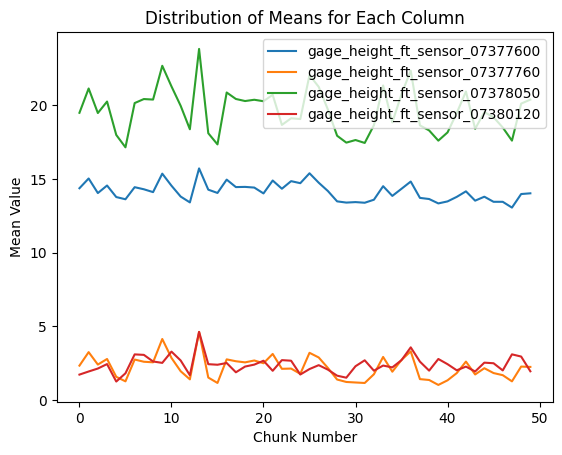

In [ ]:
fig, ax = plt.subplots()
means.plot(ax=ax, kind='line', legend=True)
ax.set_title('Distribution of Means for Each Column')
ax.set_xlabel('Chunk Number')
ax.set_ylabel('Mean Value')
plt.show()

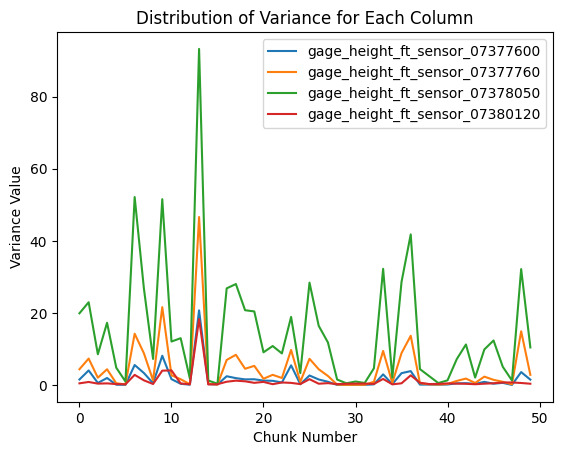

In [ ]:
fig, ax = plt.subplots()
variances.plot(ax=ax, kind='line', legend=True)
ax.set_title('Distribution of Variance for Each Column')
ax.set_xlabel('Chunk Number')
ax.set_ylabel('Variance Value')
plt.show()

In [ ]:
from matplotlib import pyplot as plt

In [ ]:
values = data.values

In [ ]:
values

array([[13.79,  1.91, 17.87,  1.7 ],
       [13.79,  1.91, 17.85,  1.71],
       [13.79,  1.9 , 17.86,  1.72],
       ...,
       [13.34,  1.66, 19.62,  2.35],
       [13.34,  1.65, 19.7 ,  2.35],
       [13.35,  1.66, 19.77,  2.33]])

In [ ]:
data.head()

,gage_height_ft_sensor_07377600,gage_height_ft_sensor_07377760,gage_height_ft_sensor_07378050,gage_height_ft_sensor_07380120
Date/Time,,,,
2015-01-01 00:00:00-06:00,13.79,1.91,17.87,1.70
2015-01-01 00:15:00-06:00,13.79,1.91,17.85,1.71
2015-01-01 00:30:00-06:00,13.79,1.90,17.86,1.72
2015-01-01 00:45:00-06:00,13.79,1.90,17.85,1.72
2015-01-01 01:00:00-06:00,13.79,1.90,17.85,1.72


In [ ]:
import tensorflow as tf
from tensorflow import keras
import pandas as pd

import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras import backend as K
from sklearn import preprocessing

# **Splitting Data**

In [ ]:
percentage = 0.8
splitting_time = int(len(data) * percentage)

train_x = np.array(data.values[:splitting_time],dtype=np.float32)
val_x = np.array(data.values[splitting_time:],dtype=np.float32)

print("train dataset size : %d" %len(train_x))
print("validation dataset size : %d" %len(val_x))

train dataset size : 168344
validation dataset size : 42087


In [ ]:
# Construction of the series

train_x = tf.convert_to_tensor(train_x)
test_x = tf.convert_to_tensor(val_x)

scaler = preprocessing.MinMaxScaler()
scaler.fit(train_x)

train_x_norm = scaler.transform(train_x)
val_x_norm = scaler.transform(val_x)

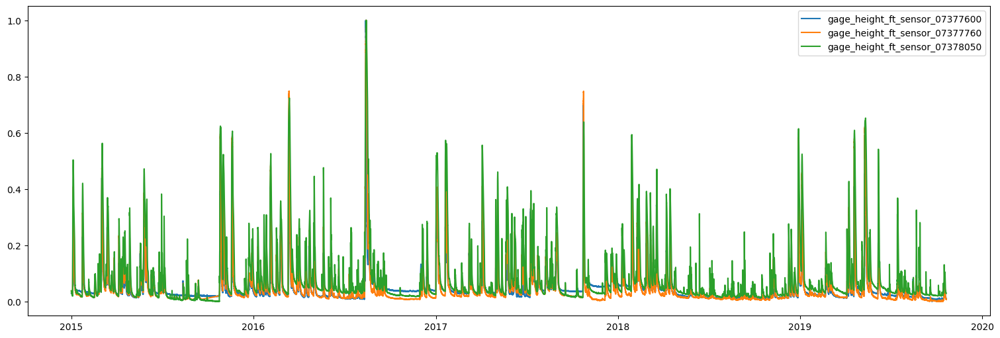

In [ ]:
# Displaying some scaled series
cols = list(data.columns)

fig, ax = plt.subplots(constrained_layout=True, figsize=(15,5))
for i in range(3):
  ax.plot(data.index[:splitting_time].values,train_x_norm[:,i], label= cols[i])
ax.legend()
plt.show()

# **Data Preparation**

In [ ]:
def prepare_dataset_XY(seriesx, seriesy, len_seq, len_out, batch_size,shift):
  '''
  A function for creating a tf.dataset from time series data as follows:
  dataset : {X,Y}
  X = {((X1_1,X1_2,...,X1_T),(X2_1,X2_2,...,X2_T),(X3_1,X3_2,...,X3_T)),
       (Y1,Y2,...,YT)}
  Y = YT+1
  seriesx-- Exogenous series, shape: (Tx, number_of_exogenous_series) with Tx: length of the time series
  seriesy-- Target series, shape: (Tx, 1)
  len_seq-- Sequence length: integer
  len_out-- Length of the predicted sequence (output): integer
  shift-- The window offset: integer
  batch_size-- Size of the batch: integer

  '''
  # Exogenous series
  # ((X1_1,X1_2,...,X1_T),(X2_1,X2_2,...,X2_T),(X3_1,X3_2,...,X3_T),....)
  dataset_x = tf.data.Dataset.from_tensor_slices(seriesx)
  dataset_x = dataset_x.window(len_seq+len_out, shift = shift, drop_remainder=True)
  dataset_x = dataset_x.flat_map(lambda x: x.batch(len_seq+len_out))
  dataset_x = dataset_x.map(lambda x: x[0:len_seq][:,:]) # shape:[[ ]]
  dataset_x = dataset_x.batch(batch_size, drop_remainder=True).prefetch(1) # shape: [[[]]] (adding the batch_size)

  # The target series
  # (Y1,Y2,...,YT)
  dataset_y = tf.data.Dataset.from_tensor_slices(seriesy)
  dataset_y = dataset_y.window(len_seq+len_out, shift = shift, drop_remainder=True)
  dataset_y = dataset_y.flat_map(lambda x: x.batch(len_seq+len_out))
  dataset_y = dataset_y.map(lambda x: x[0:len_seq][:,:])
  dataset_y = dataset_y.batch(batch_size, drop_remainder=True).prefetch(1)

  # Y = YT+1 (the values to predict)
  dataset_ypred = tf.data.Dataset.from_tensor_slices(seriesy)
  dataset_ypred = dataset_ypred.window(len_seq+len_out+1, shift=shift, drop_remainder=True)
  dataset_ypred = dataset_ypred.flat_map(lambda x: x.batch(len_seq+len_out+1))
  dataset_ypred = dataset_ypred.map(lambda x: (x[0:len_seq+1][-len_out:,:]))
  dataset_ypred = dataset_ypred.batch(batch_size, drop_remainder=True).prefetch(1)

  dataset = tf.data.Dataset.zip((dataset_x, dataset_y))
  dataset = tf.data.Dataset.zip((dataset, dataset_ypred))
  return dataset

In [ ]:

batch_size = 128
len_seq = 20
len_out = 1
shift=1

# Dataset creation
dataset = prepare_dataset_XY(train_x_norm[:,0:-1], train_x_norm[:,-1:], len_seq, len_out, batch_size, shift)
dataset_val = prepare_dataset_XY(val_x_norm[:,0:-1], val_x_norm[:,-1:], len_seq, len_out, batch_size, shift)

In [ ]:
# Number of batches (train dataset)
print(len(list(dataset.as_numpy_iterator())))

print(("---------------"))
for element in dataset.take(1):
  print(element[0][0].shape)
  print(element[0][1].shape)
  print(element[1].shape)

1315
---------------
(128, 20, 3)
(128, 20, 1)
(128, 1, 1)


In [ ]:
# Number of batches (validation dataset)

print(len(list(dataset_val.as_numpy_iterator())))
print(("---------------"))
for element in dataset.take(1):
  print(element[0][0].shape)
  print(element[0][1].shape)
  print(element[1].shape)

328
---------------
(128, 20, 3)
(128, 20, 1)
(128, 1, 1)


In [ ]:
dataset

<_ZipDataset element_spec=((TensorSpec(shape=(128, None, 3), dtype=tf.float64, name=None), TensorSpec(shape=(128, None, 1), dtype=tf.float64, name=None)), TensorSpec(shape=(128, None, 1), dtype=tf.float64, name=None))>

In [ ]:
X1 = []
X2 = []


# Extracting x and y from the dataset
x,y = tuple(zip(*dataset))  #x: 17x((BS,20,16),(BS,20,1)) with BS refers to Batch Size
                           #y: 17x(BS,1,1)
for i in range(len(x)):
  X1.append(x[i][0])
  X2.append(x[i][1])



X1 = np.asarray(X1, dtype = np.float32) # (17,BS,20,16)
X2 = np.asarray(X2, dtype = np.float32) # (17,BS,20,1)
y =  np.asarray(y, dtype= np.float32)   # (17,BS,1,1)

# Reshaping them
X1 = np.reshape(X1,(X1.shape[0]*X1.shape[1], X1.shape[2], X1.shape[3])) # (17,BS,20,16) --> (17xBS,20,16)
X2 = np.reshape(X2,(X2.shape[0]*X2.shape[1], X2.shape[2], X2.shape[3])) # (17,BS,20,1)  --> (17xBS,20,1)


x_train = [X1,X2]
y_train = np.reshape(y,(y.shape[0]*y.shape[1], y.shape[2], y.shape[3])) # (17,BS,1,1) --> (17xBS,1,1)

print(x_train[0].shape)
print(x_train[1].shape)
print(y_train.shape)

(168320, 20, 3)
(168320, 20, 1)
(168320, 1, 1)


In [ ]:
# Extracting x and y from the validation dataset
X1 =[]
X2 =[]
x,y = tuple(zip(*dataset_val))

for i in range(len(x)):
  X1.append(x[i][0])
  X2.append(x[i][1])

X1 = np.asarray(X1,dtype=np.float32)
X2 = np.asarray(X2, dtype = np.float32)
y = np.asarray(y, dtype= np.float32)

# Reshaping them
X1 = np.reshape(X1,(X1.shape[0]*X1.shape[1], X1.shape[2], X1.shape[3]))
X2 = np.reshape(X2,(X2.shape[0]*X2.shape[1], X2.shape[2], X2.shape[3]))

x_val = [X1,X2]
y_val = np.reshape(y,(y.shape[0]*y.shape[1], y.shape[2], y.shape[3]))

print(x_val[0].shape)
print(x_val[1].shape)
print(y_val.shape)

(41984, 20, 3)
(41984, 20, 1)
(41984, 1, 1)


# **Model Architecture**

In [ ]:
class CreationSpatialEmbeddings(tf.keras.layers.Layer):
    def __init__(self, dim_emb_space):
        self.dim_emb_space = dim_emb_space
        super().__init__()

    def build(self,input_shape):
        dense_layers = []
        input_dense_layers = []

        # Creation of the input for the N dense layers
        # input_shape = (BS,Tx,N), with BS= Batch_Size
        for i in range(input_shape[2]):
            input_dense_layers.append(tf.keras.Input(shape=(input_shape[1])))   #input_dense_layers: N*(BS,Tx)

        # Creation of the N dense layers
        for i in range(input_shape[2]):
            dense_layer = tf.keras.layers.Dense(units=self.dim_emb_space)(input_dense_layers[i]) # (BS, dim_emb_sapce)
            dense_layers.append(dense_layer) # N*(BS,dim_emb_space)

        # Creation of the output of the N dense layers
        out = tf.convert_to_tensor(dense_layers) # (N,BS,dim_emb_sapce)
        out = tf.transpose(out,perm=[1,0,2]) # (BS,N,dim_emb_sapce)/this shape for the Encoder(that will use keras TimeDistributed)

        # Creation of the Global Model
        self.Dense_Embeddings = tf.keras.Model(inputs=input_dense_layers, outputs=out)
        super().build(input_shape)

    # Inputs :
    # input is the Exogenous series & Target series : (BS,Tx,N)
    # Outputs :
    # spatial_embeddings are the Spatial Embeddings : (BS,N,dim_emb_space)
    def call(self, input):
        input_list = tf.unstack(input,axis=2)   # N*(BS,Tx), to have the same shape of the model input, above
        spatial_embeddings = self.Dense_Embeddings(input_list)    # (BS,N,dim_emb_space)
        return spatial_embeddings


In [ ]:
class CreationTemporalEmbeddings(tf.keras.layers.Layer):
    def __init__(self, dim_emb_temp):
        self.dim_emb_temp = dim_emb_temp
        super().__init__()

    def build(self,input_shape):
        self.layer_lstm1 = tf.keras.layers.LSTM(units=self.dim_emb_temp, return_sequences=True)
        self.layer_lstm2 = tf.keras.layers.LSTM(units=self.dim_emb_temp, return_sequences=True)
        super().build(input_shape)

    # Inputs :
    # input is Exogenous series & Target series  : (BS,Tx,N)
    # Outputs :
    # out_lstm are the Temporal Embeddings : (BS,Tx,dim_emb_temp)
    def call(self, input):
        out_lstm = self.layer_lstm1(input)      #(BS,Tx,dim_emb_temp)
        out_lstm = self.layer_lstm2(out_lstm)   #(BS,Tx,dim_emb_temp)
        return out_lstm

In [ ]:
class BlocScoresComputation_SpatialEncoder(tf.keras.layers.Layer):
    def __init__(self):
        super().__init__()

    def build(self, input_shape):
        self.DenseLayerScoresEncSpatial = tf.keras.layers.Dense(units=1,activation="relu")
        super().build(input_shape)

    def compute_output_shape(self, input_shape):
        return (input_shape[0], 1) # output_shape = (BS,1)

    # hidd_state is the hidden_state : (BS,#LSTMG)
    # I didn't include it as a parameter in call function below,because I won't be able to use this bloc later in Time Distributed
    def SetStates(self,hidd_state):
        self.hidd_state = hidd_state

    # Inputs:
    # embeddings are the Spatial_Embeddings :(BS, dim_emb_space)
    # Outputs:
    # score : (BS,1)

    def call(self, spatial_embeddings):
        embeddings = tf.concat([spatial_embeddings, self.hidd_state],axis=1)  #(BS, dim_emb_sapce+LSTMG)
        score = self.DenseLayerScoresEncSpatial(embeddings)                   #(BS,1)
        return score

In [ ]:
class SpatialAttention_SpatialEncoder(tf.keras.layers.Layer):
    def __init__(self):
        super().__init__()

    def build(self,input_shape):
        self.layer_ScoresComputation_SpatialEncoder = BlocScoresComputation_SpatialEncoder()
        super().build(input_shape)

    # Inputs :
    # input is the Spatial Embeddings : (BS, N, dim_emb_sapce)
    # hid_state : Hidden state of the Spatial Decoder : (BS, LSTMG)

    # Outputs :
    # g is the Spatial Context Vector : (BS, dim_emb_space)


    def call(self, input,  hid_state):
        # Scores computation (in //)
        self.layer_ScoresComputation_SpatialEncoder.SetStates(hid_state)
        beta = tf.keras.layers.TimeDistributed(
        self.layer_ScoresComputation_SpatialEncoder)(input)  # (BS, dim_emb_space) sent N times in //
                                                             # returns (BS,N,1)
        # Scores Nomalization
        beta = tf.keras.activations.softmax(beta,axis=1)     # (BS,N,1)

        # Spatial Context Vector computation
        g = tf.multiply(input, beta)    # (BS,N,dim_emb_space) x (BS,N,1) = (BS,N,dim_emb_space)
        g = K.sum(g, axis=1)            # (BS,dim_emb_space)
        return g

In [ ]:
class BlocScoresComputation_TemporalEncoder(tf.keras.layers.Layer):
    def __init__(self):
        super().__init__()

    def build(self, input_shape):
        self.DenseLayerScoresEncTemporal = tf.keras.layers.Dense(units=1,activation="relu")
        super().build(input_shape)

    def compute_output_shape(self, input_shape):
        return (input_shape[0], 1) # output_shape = (BS,1)

    # hidd_state is the hidden_state : (BS,#LSTMS)
    # I didn't include it as a parameter in call function below,because I won't be able to use this bloc later in Time Distributed

    def SetStates(self,hidd_state):
        self.hidd_state = hidd_state

    # Inputs:
    # temporal_embeddings :(BS, dim_emb_temp)
    # Outputs
    # score : (BS,1)

    def call(self, temporal_embeddings):
        embeddings = tf.concat([temporal_embeddings, self.hidd_state],axis=1)  #(BS, dim_emb_temp+LSTMS)
        score = self.DenseLayerScoresEncTemporal(embeddings)                   #(BS,1)
        return score

In [ ]:
class TemporalAttention_TemporalEncoder(tf.keras.layers.Layer):
    def __init__(self):
        super().__init__()

    def build(self,input_shape):
        self.layer_ScoresComputation_TemporalEncoder = BlocScoresComputation_TemporalEncoder()
        super().build(input_shape)

    # Inputs :
    # input is the Temporal Embeddings : (BS, Tx, dim_emb_temp)
    # hid_state : Hidden state of the Temporal Decoder : (BS, LSTMS)
    # Outputs :
    # s is the Temporal Context Vector : (BS, dim_emb_temp)

    def call(self, input,  hid_state):
        # Scores computation (in //)
        self.layer_ScoresComputation_TemporalEncoder.SetStates(hid_state)
        alpha = tf.keras.layers.TimeDistributed(
        self.layer_ScoresComputation_TemporalEncoder)(input) # (BS, dim_emb_temp) sent Tx times in //
                                                             # returns (BS,Tx,1)
        # Scores Nomalization
        alpha = tf.keras.activations.softmax(alpha,axis=1)       # (BS,Tx,1)

        # Temporal Context Vector computation
        s = tf.multiply(input, alpha)    # (BS,Tx,dim_emb_temp) x (BS,Tx,1) = (BS,Tx,dim_emb_temp)
        s = K.sum(s, axis=1)             # (BS,dim_emb_temp)
        return s

In [ ]:
class SpatialDecoder(tf.keras.layers.Layer):
    def __init__(self, dim_LSTMG,dim_G,regul,drop):
        self.drop = drop
        self.regul = regul
        self.dim_LSTMG = dim_LSTMG          # Dimension of the hidden states
        self.dim_G = dim_G                  # Reduced dimension of the spatial context vector
        super().__init__()

    def build(self,input_shape):
        self.SpatialReducedLayer = tf.keras.layers.Dense(units=self.dim_G,activation="relu")
        self.LayerLSTMG = tf.keras.layers.LSTM(units=self.dim_LSTMG,return_state=True,kernel_regularizer=tf.keras.regularizers.l2(self.regul),
                                           dropout=self.drop,recurrent_dropout=self.drop,name="LSTM_SpatialDecoder")
        super().build(input_shape)
    # inputs :
    # vc_spatial : Spatial Context Vector : (BS,dim_emb_space)
    # hid_state_1 : Hidden state of the Spatial Decoder (t-1) : (BS,LSTMG)
    # cell_state_1 : Cell state of the Spatial Decoder (t-1)  : (BS,LSTMG)

    # y_pred_0 :  Prediction of (t-1) : (BS,1,1)

    # Outputs :
    # hid_state : Hidden state of the Spatial Deocder (t): (BS,LSTMG)
    # cell_state : Cell state of the Spatial Decoder (t): (BS,LSTMG)

    def call(self, vc_spatial,hid_state_1,cell_state_1,y_pred_0):
        # Reduction of the Spatial Context Vector
        rg = self.SpatialReducedLayer(vc_spatial)    # (BS,dim_G)

        # Concatenation of the reduced vector with the prediction at (t-1)
        rg = tf.concat([rg,tf.squeeze(y_pred_0,-1)],axis=1)     # (BS,dim_G + 1)
        rg = tf.expand_dims(rg,-1)                              # (BS,dim_G + 1,1)

        # Applying the LSTM layer
        out_dec, hid_state, cell_state = self.LayerLSTMG(rg,initial_state=[hid_state_1,cell_state_1])
        return hid_state,cell_state

In [ ]:
class TemporalDecoder(tf.keras.layers.Layer):
    def __init__(self, dim_LSTMS,dim_S,regul,drop):
        self.drop = drop
        self.regul = regul
        self.dim_LSTMS = dim_LSTMS          # Dimension of the hidden states
        self.dim_S = dim_S                  # Reduced dimension of the Temporal context vector
        super().__init__()

    def build(self,input_shape):
        self.TemporalReducedLayer = tf.keras.layers.Dense(units=self.dim_S,activation="relu")
        self.LayerLSTMS = tf.keras.layers.LSTM(units=self.dim_LSTMS,return_state=True, kernel_regularizer=tf.keras.regularizers.l2(self.regul),
                                            dropout=self.drop,recurrent_dropout=self.drop,name="LSTM_TemporalDecoder")
        super().build(input_shape)

    # Inputs :
    # vc_tempo : Temporal Context Vector: (BS,dim_emb_temp)
    # hid_state_1 : Hidden state of the Temporal Decoder (t-1) : (BS,LSTMS)
    # cell_state_1 : Cell state of the Temporal Decoder (t-1)  : (BS,LSTMS)
    # y_pred_0 :  Prediction (t-1) : (BS,1,1)

    # Outputs :
    # hid_state : Hidden state of the Temporal Decoder (t): (BS,LSTMS)
    # cell_state : Cell state of the Temporal Decoder (t) : (BS,LSTMS)

    def call(self, vc_tempo,hid_state_1,cell_state_1,y_pred_0):
        # Reduction of the Temporal Context Vector
        rs = self.TemporalReducedLayer(vc_tempo)  # (BS,dim_S)

        # Concatenation of the reduced vector with the prediction at (t-1)
        rs = tf.concat([rs,tf.squeeze(y_pred_0,-1)],axis=1) # (BS,dim_S + 1)
        rs = tf.expand_dims(rs,-1)                          # (BS,dim_S + 1,1)

        # Applying LSTMS
        out_dec, hid_state, cell_state = self.LayerLSTMS(rs,initial_state=[hid_state_1,cell_state_1])
        return hid_state,cell_state

# **Final Model**

In [ ]:


class Final_STAM(tf.keras.layers.Layer):
    def __init__(self,creationspatialembeddings, creationtemporalembeddings, spatialencoder, temporalencoder,
               spatialdecoder,temporaldecoder,len_seq, len_out, regul, drop,dim_LSTMG,dim_LSTMS):
        self.creationspatialembeddings = creationspatialembeddings
        self.creationtemporalembeddings = creationtemporalembeddings
        self.spatialencoder = spatialencoder
        self.temporalencoder = temporalencoder
        self.spatialdecoder = spatialdecoder
        self.temporaldecoder = temporaldecoder
        self.len_seq = len_seq
        self.len_out = len_out
        self.regul = regul
        self.drop = drop
        self.dim_LSTMG = dim_LSTMG
        self.dim_LSTMS = dim_LSTMS
        super().__init__()

    def build(self,input_shape):
        self.FirstLayerDense = tf.keras.layers.Dense(units=self.dim_LSTMG+self.dim_LSTMS,activation="tanh")
        self.LayerPrediction = tf.keras.layers.Dense(units=1)
        super().build(input_shape)

    # Inputs :
    # input:  Exegonous series : (BS,Tx,N-1)
    # target: Target series    : (BS,Tx,1)

    # Outputs :
    # outputs : Prédiction(s) Y : (BS,len_out,1)

    def call(self,input,target):
        # Creation of spatial embeddings
        spatial_embdgs = self.creationspatialembeddings(tf.concat([input,target],axis=-1))  #(BS,N,dim_emb_space)
        temporal_embdgs = self.creationtemporalembeddings(tf.concat([input,target],axis=-1))#(BS,N,dim_emb_temp)

        # Initialize hidden_states and cells_states
        hid_state_spatial_1 = tf.matmul(input[:,0:1,0:1],tf.zeros(shape=(1,self.dim_LSTMG))) #(BS,1,1)x(1,dim_LSTMG)
                                                                                             #(BS,1,dim_LSTMG)
        hid_state_spatial_1 = tf.transpose(hid_state_spatial_1,perm=[0,2,1])  #(BS,dim_LSTMG,1)
        hid_state_spatial_1 = tf.squeeze(hid_state_spatial_1,-1)              #(BS,dim_LSTMG)
        cell_state_spatial_1 = hid_state_spatial_1

        hid_state_temporal_1 = tf.matmul(input[:,0:1,0:1],tf.zeros(shape=(1,self.dim_LSTMS)))  #(BS,1,1)x(1,dim_LSTMS)
                                                                                               #(BS,1,dim_LSTMS)
        hid_state_temporal_1 = tf.transpose(hid_state_temporal_1,perm=[0,2,1])   #(BS,dim_LSTMS,1)
        hid_state_temporal_1 = tf.squeeze(hid_state_temporal_1,-1)               #(BS,dim_LSTMS)
        cell_state_temporal_1 = hid_state_temporal_1

        # Initialize the prédiction at t=0
        y_pred_0 = tf.matmul(target[:,0:1,:],tf.zeros(shape=(1,1)))   #(BS,1,1)x(1,1) = (BS,1,1)

        outputs = []
        for t in range(self.len_out):
            # Computation of the spatial & temporal context vectors
            g = self.spatialencoder(spatial_embdgs,hid_state_spatial_1)       # (BS,dim_emb_space)
            s = self.temporalencoder(temporal_embdgs,hid_state_temporal_1)    # (BS,dim_emb_temp)

            # Spatial & Temporal Decoders
            hid_state_dec_spatial,cell_state_dec_spatial = self.spatialdecoder(
                g,hid_state_spatial_1,cell_state_spatial_1,y_pred_0)          #(BS,dim_LSTMG)
            hid_state_dec_temporal,cell_state_dec_temporal = self.temporaldecoder(
                s,hid_state_temporal_1,cell_state_temporal_1,y_pred_0)        #(BS,dim_LSTMS)

            # Concatenation of the hidden states & context vectors
            out_dec = tf.concat([hid_state_dec_spatial,hid_state_dec_temporal,g,s],axis=1)
            # out_dec: (BS, dim_LSTMG + dim_LSTMS+ dim_emb_space+ dim_emb_tempo)

            y_pred_1 = self.FirstLayerDense(out_dec)       #(BS,dim_LSTMG+dim_LSTMS)
            y_pred_1 = self.LayerPrediction(y_pred_1)      #(BS,1)
            y_pred_1 = tf.expand_dims(y_pred_1,-1)         #(BS,1,1)

            outputs.append(y_pred_1)

            # The new values of the hidden states & cell states (fot the next time step in len_out)
            hid_state_spatial_1 = hid_state_dec_spatial
            cell_state_spatial_1 = cell_state_dec_spatial
            hid_state_temporel_1 = hid_state_dec_temporal
            cell_state_temporel_1 = cell_state_dec_temporal
        outputs = tf.convert_to_tensor(outputs)         # (len_out,BS,1,1)
        outputs = tf.squeeze(outputs,-1)                # (len_out,BS,1)
        outputs = tf.transpose(outputs,perm=[1,0,2])    # (BS,len_out,1)
        return outputs

In [ ]:
dim_space = 128
dim_temp = 128

dim_LSTMG = 128
dim_LSTMS = 128
dim_G = 128 # I used basic value/ But because this param is designed to be a reduction of dim_LSTMG, you can experiment with it to see how the performance changes.
dim_S = 128 # I used basic value/ But because this param is designed to be a reduction of dim_LSTMS, you can experiment with it to see how the performance changes.
drop=0.0
l2reg=0.0

def get_stam_model():

    inputs_exogenous = tf.keras.layers.Input(shape=(len_seq,x_train[0].shape[2]))
    input_target = tf.keras.layers.Input(shape=(len_seq,1))

    creationspatialembeddings = CreationSpatialEmbeddings(dim_emb_space = dim_space)
    creationtemporalembeddings = CreationTemporalEmbeddings(dim_emb_temp= dim_temp)
    spatialencoder = SpatialAttention_SpatialEncoder()
    temporalencoder = TemporalAttention_TemporalEncoder()
    spatialdecoder = SpatialDecoder(dim_LSTMG=dim_LSTMG,dim_G=dim_G,regul=l2reg,drop=drop)
    temporaldecoder = TemporalDecoder(dim_LSTMS=dim_LSTMS,dim_S=dim_S,regul=l2reg,drop=drop)

    output = Final_STAM(creationspatialembeddings,creationtemporalembeddings,spatialencoder,temporalencoder,
                      spatialdecoder,temporaldecoder,len_seq,len_out,
                      l2reg,drop,dim_LSTMG,dim_LSTMS)(inputs_exogenous,input_target)

    model = tf.keras.Model([inputs_exogenous,input_target],output)
    return model


In [ ]:
max_periods = 50
# instantiate a distribution strategy

    #creation of the model
model = get_stam_model()

    # Definition of the parameters related to the evolution of the learning rate
lr_schedule = tf.keras.optimizers.schedules.InverseTimeDecay(
      initial_learning_rate=0.001,
      decay_steps=50,
      decay_rate=0.01)
optimiseur=tf.keras.optimizers.Adam(learning_rate=lr_schedule)

# Using ModelCheckPoint
CheckPoint = tf.keras.callbacks.ModelCheckpoint("weights_train.hdf5", monitor='loss', verbose=1,
                                                  save_best_only=True, save_weights_only = True, mode='auto',
                                                  save_freq='epoch')
 # Compile the model
model.compile(loss="mse", optimizer=optimiseur)

    # train the model
history = model.fit(x=[x_train[0],x_train[1]],y=y_train,validation_data=([x_val[0],x_val[1]],y_val),
                      epochs=max_periods,verbose=1,
                      callbacks=[CheckPoint,tf.keras.callbacks.EarlyStopping(monitor='loss', patience=60)],
                      batch_size=batch_size)

Epoch 1/20
1315/1315 [==============================] - ETA: 0s - loss: 8.9242e-05
Epoch 1: loss improved from inf to 0.00009, saving model to weights_train.hdf5
1315/1315 [==============================] - 1246s 940ms/step - loss: 8.9242e-05 - val_loss: 4.2454e-06
Epoch 2/20
1315/1315 [==============================] - ETA: 0s - loss: 3.8907e-06
Epoch 2: loss improved from 0.00009 to 0.00000, saving model to weights_train.hdf5
1315/1315 [==============================] - 1115s 848ms/step - loss: 3.8907e-06 - val_loss: 1.4944e-06
Epoch 3/20
1315/1315 [==============================] - ETA: 0s - loss: 3.7951e-06
Epoch 3: loss improved from 0.00000 to 0.00000, saving model to weights_train.hdf5
1315/1315 [==============================] - 1116s 848ms/step - loss: 3.7951e-06 - val_loss: 2.2117e-06
Epoch 4/20
1315/1315 [==============================] - ETA: 0s - loss: 3.5971e-06
Epoch 4: loss improved from 0.00000 to 0.00000, saving model to weights_train.hdf5
1315/1315 [=================

In [ ]:
pred_train = model.predict([x_train[0],x_train[1]],verbose=1)
pred_val = model.predict([x_val[0],x_val[1]],verbose=1)

1312/1312 [==============================] - 173s 132ms/step


# **Model Evaluation**

In [ ]:
import plotly.graph_objects as go

shift = 1
fig = go.FigureWidget()

# Original series of 'Indoor_Temperature_room'
fig.add_trace(go.Scatter(x=data.index,y=train_x_norm [:,-1],line = {'color':'blue', 'width':1}, name= 'gage_height_ft_sensor_07380120_train'))
fig.add_trace(go.Scatter(x=data.index[splitting_time:],y=val_x_norm[:,-1],line = {'color':'red', 'width':1}, name = 'gage_height_ft_sensor_07380120_val'))

# Dislply the predictions (for the train dataset)
preds = []

max = len(pred_train)
max = max
for i in range(0,max):
  preds.append(tf.squeeze(pred_train[i,0:shift,:],1))
preds = tf.convert_to_tensor(preds).numpy()
preds = np.reshape(preds,(preds.shape[0]*preds.shape[1]))

fig.add_trace(go.Scatter(x=data.index[len_seq:],y=preds, mode='lines', line={'color':'yellow', 'width':1}, name = 'predictions_train'))

# Dislply the predictions (for the validation dataset)
predsv = []
max2 = len(pred_val)

for i in range(0,max2):
  predsv.append(tf.squeeze(pred_val[i,0:shift,:],1))

predsv = tf.convert_to_tensor(predsv).numpy()
predsv = np.reshape(predsv,(predsv.shape[0]*predsv.shape[1]))

fig.add_trace(go.Scatter(x=data.index[splitting_time+len_seq:],y=predsv, mode='lines', line={'color':'green', 'width':1}, name = 'predictions_val'))

fig.update_xaxes(rangeslider_visible=True)
yaxis=dict(autorange = True,fixedrange= False)
fig.update_yaxes(yaxis)
fig.show()

In [ ]:
train_x_norm_2 = train_x_norm[len_seq:-(train_x_norm[len_seq:,:].shape[0]-preds.shape[0]),:]
train_x_norm_2_s = scaler.inverse_transform(train_x_norm_2)

gage_height_ft_sensor_07380120_real = train_x_norm_2_s[:,-1]
gage_height_ft_sensor_07380120_real

array([1.86000001, 1.87      , 1.88999999, ..., 3.3900001 , 3.4000001 ,
       3.4000001 ])

In [ ]:
train_x_norm_preds = train_x_norm_2.copy()
train_x_norm_preds[:,-1] = preds
train_x_norm_preds_s = scaler.inverse_transform(train_x_norm_preds)

gage_height_ft_sensor_07380120_preds = train_x_norm_preds_s[:,-1]
gage_height_ft_sensor_07380120_preds

array([1.84800037, 1.86148999, 1.87311322, ..., 3.39444763, 3.39242317,
       3.39439236])

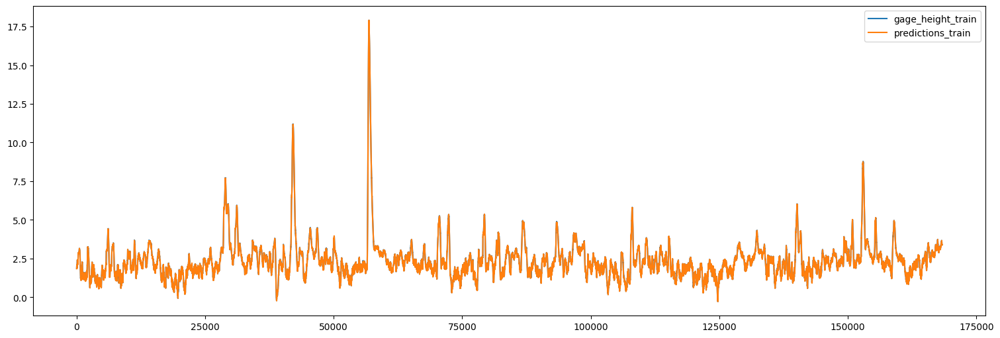

In [ ]:
df_2 = pd.DataFrame({'gage_height_train':gage_height_ft_sensor_07380120_real,'predictions_train':gage_height_ft_sensor_07380120_preds})

fig, ax = plt.subplots(constrained_layout=True, figsize=(15,5))
for i in range(2):
  ax.plot(df_2.index.values,df_2.values[:,i], label= list(df_2.columns)[i])
ax.legend()
plt.show()

In [ ]:
# Compute the MSE on the training dataset
mse_train = tf.keras.losses.mse(gage_height_ft_sensor_07380120_real,gage_height_ft_sensor_07380120_preds)
print( f"MSE on the train dataset is: {mse_train.numpy()}")

MSE on the train dataset is: 0.0002385853213464033


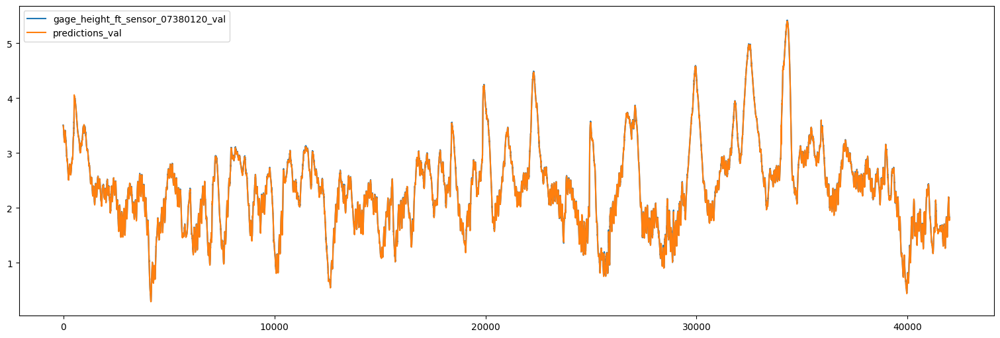

In [ ]:
val_x_norm_2 = val_x_norm[len_seq:-(val_x_norm[len_seq:,:].shape[0]-predsv.shape[0]),:]
val_x_norm_2_s = scaler.inverse_transform(val_x_norm_2)
gage_height_ft_sensor_07380120_val = val_x_norm_2_s[:,-1]

val_x_norm_preds = val_x_norm_2.copy()
val_x_norm_preds[:,-1] = predsv

val_x_norm_preds_s = scaler.inverse_transform(val_x_norm_preds)

preds_val = val_x_norm_preds_s[:,-1]

df_3 = pd.DataFrame({'gage_height_ft_sensor_07380120_val':gage_height_ft_sensor_07380120_val,'predictions_val':preds_val})


fig, ax = plt.subplots(constrained_layout=True, figsize=(15,5))
for i in range(2):
  ax.plot(df_3.index.values,df_3.values[:,i], label= list(df_3.columns)[i])
ax.legend()
plt.show()

In [ ]:
# Compute the MSE on the validation dataset
mse_val = tf.keras.losses.mse(gage_height_ft_sensor_07380120_val,preds_val)
print( f"MSE on the validation dataset is: {mse_val.numpy()}")

MSE on the validation dataset is: 0.00022171765158418566
